In [1]:
from PIL import Image,ImageFilter
import numpy as np
import matplotlib.pyplot as plt
import os
import pickle
import scipy
from scipy.signal import wiener
from scipy.signal import convolve2d
from __future__ import division
import scipy.stats as stats
from matplotlib.colors import LogNorm
import warnings
import matplotlib

warnings.filterwarnings('ignore')
%matplotlib inline

font = {'family' : 'arial',
        'weight' : 'bold',
        'size'   : 20}

matplotlib.rc('font', **font)

In [2]:
def ListofFiles(path):
    filelist=[]
    for root, dirs, files in os.walk(path):
        for file in files:
             filelist.append(os.path.join(root,file))
    return filelist

def getImageValues(Files,EventLimit=1):
    if(type(Files) is list):
        values={}
        count=0
        for file in Files:
            img1=Image.open(file)
            imgArray=np.array(img1)
            values[count]=imgArray
            count+=1
            if(EventLimit==count):
                break
        print(f" {count} frames in dictinary ")
    else:
        img1=Image.open(Files)
        values=np.array(img1)
    return values

def AverageIt(data):
    count=0
    Total=0
    for i in range (0,len(data)):
        Total+=data[i]  
        count+=1
    Averaged=Total/count
    values=0
    for i in range (0,len(data)):
        values+=(data[i]-Averaged)**2
        
    stdev=np.sqrt(values/(count-1))    
    print(f"Total Events Averaged is {count}")
    
    return Averaged,stdev

def PlotSideBySide(EL,Background):
    fig, axs = plt.subplots(1, 2,figsize=(15,12))
    BkSubstracted=EL-Background[0]
    axs[0].set_title("BackGround Substracted")
    axs[0].imshow(BkSubstracted,cmap='gray')
    axs[1].set_title("With Background")
    axs[1].imshow(EL,cmap='gray')

    plt.show()

def Plot(EL):
    plt.figure(figsize=(15,12))
    plt.title("Tracks")
    plt.imshow(EL)

    plt.show()
#    https://www.owlnet.rice.edu/~elec539/Projects99/BACH/proj2/wiener.html




def Ppectrum(img,bgn,Title):

    npix=img.shape[0]

    ## Obtain the freq
    kfreq=np.fft.fftfreq(npix)*npix

    ## Create a meshgrid
    kfreq2D=np.meshgrid(kfreq,kfreq)
    ## Normalize it
    knrm=np.sqrt(kfreq2D[0]**2+kfreq2D[1]**2)

    ## Convert it to 1d array
    knrm=knrm.flatten()
    Fourier_Amplitudes_img1=img.flatten()
    Fourier_Amplitudes_background=bgn.flatten()
    print(len(Fourier_Amplitudes_img1))
    ### binning 
    kbins = np.arange(0.5, npix//2+1, 1)

    kvals = 0.5 * (kbins[1:] + kbins[:-1])
    Abins, _, _ = stats.binned_statistic(knrm, Fourier_Amplitudes_img1,
                                         statistic = "mean",
                                         bins = kbins)
    AbinsBackground, _, _ = stats.binned_statistic(knrm, Fourier_Amplitudes_background,
                                         statistic = "mean",
                                         bins = kbins)
    Abins *= np.pi * (kbins[1:]**2 - kbins[:-1]**2)
    AbinsBackground *= np.pi * (kbins[1:]**2 - kbins[:-1]**2)

    '''ImgY=Abins/kvals
    BgY=AbinsBackground/kvals
    ### Mask it
    xlow=25
    xhigh=240
    Mask=np.where(np.logical_and(kvals>=xlow,kvals<=xhigh))
    

    
    IntegralBG=np.trapz(BgY[Mask],dx=1)
    IntegralSig=np.trapz(ImgY[Mask],dx=1)
    BgNormed=BgY*(IntegralSig/IntegralBG)
    
    weiner=(ImgY-BgNormed)/ImgY
    weinerNormed=(np.trapz(ImgY,dx=1)/np.trapz(weiner,dx=1))*weiner
    WeinerMask=kvals>=xlow
    weinerNormed[WeinerMask]=0
    weiner[WeinerMask]=0
    WeinerNanMask=np.isnan(weiner)
    weiner[WeinerNanMask]=0
    '''

      #WeinerByForce=(ImgY-BgY)/ImgY
    #WeinerByForceNormed=(np.trapz(ImgY,dx=1)/np.trapz(WeinerByForce,dx=1))*WeinerByForce
    #WeinerByForceNormed[WeinerMask]=0
    print(f"Minimum kval = {min(kvals)} and Maximum kval= {max(kvals)}")
    plt.plot(kvals,Abins/kvals,label="signal")
    plt.plot(kvals,AbinsBackground/kvals,label="Background")
    #plt.plot(kvals,weinerNormed,label="Weiner")

    #plt.plot(kvals,WeinerByForceNormed,label="Forced",color='y')
    plt.loglog()
    #plt.axvline(xlow,color='r')
    #plt.axvline(xhigh,color='r',label="IntegrationWindow")
    #print((Abins/kvals))
    #print(kvals)
    
    plt.axvline(25)
    plt.axvline(512)
  
    plt.title(Title)
    plt.xlabel("$k$")
    plt.ylabel("$P(k)$")
    plt.tight_layout()
    plt.legend()
    plt.show()
    #plt.savefig("img1_power_spectrum.png", dpi = 300, bbox_inches = "tight")

def PlotSideBySideWiner(EL,noise=(10,10)):
    fig, axs = plt.subplots(1, 2,figsize=(15,12))
    axs[0].set_title("Actual")
    axs[0].imshow(EL)
    axs[1].set_title("Winer Filtered")
    WinerFiltered=wiener(EL,noise)
    axs[1].imshow(WinerFiltered)

    plt.show()

def getPowerSpectrum(imgs,backgrounds,Name,xlow=100,xhigh=200):
    # take dft
    
    TotalNoisePS=0
    TotalDataPS=0
    imgdata=0
    bgdata=0
    DataCount=0
    BgnCount=0
    Signalhist=np.array([])
    Noisehist=np.array([])
    Filename=Name+".p"
    Values={}

    if(not(os.path.exists(Filename))): 
        for background in backgrounds:
            bgndfft=np.fft.fft2(backgrounds[background])
            bgspecnoise=(np.abs(bgndfft))**2
            TotalNoisePS+=bgspecnoise
            bgdata+=backgrounds[background]
            BgnCount+=1
            #Noisehist=np.append(Noisehist,np.ndarray.flatten(bgspecnoise))

        for  data in imgs :
            datadft = np.fft.fft2(imgs[data])
            signalps=(np.abs(datadft))**2
            TotalDataPS += signalps
            imgdata+=imgs[data]
            DataCount+=1
            #Signalhist=np.append(Signalhist,np.ndarray.flatten(signalps))
        
        AvgNoiseSpec=TotalNoisePS/BgnCount
        AvgDataSpec=TotalDataPS/DataCount
        
        NormAvgNoiseSpec=AvgNoiseSpec/np.max(AvgNoiseSpec)
        NormAvgDataSpec=AvgDataSpec/np.max(AvgDataSpec)
        print(NormAvgDataSpec)
        wiener1 = (NormAvgDataSpec-NormAvgNoiseSpec)/(NormAvgDataSpec)
        
        imgdataAvg=(imgdata/DataCount)
        BgndataAvg=(bgdata/BgnCount)
        Values["imgs"]=imgdataAvg
        Values["bgns"]=BgndataAvg
        Values["PSData"]=AvgDataSpec
        Values["PSBg"]=AvgNoiseSpec
        Values["Wiener2D"]=wiener1
        PickleITDump(Values,Filename)

    else:
        Values=PickleITRead(Filename)
        wiener1=Values["Wiener2D"]
        AvgDataSpec=Values["PSData"]
        AvgNoiseSpec=Values["PSBg"]
        imgdataAvg=Values["imgs"]
        BgndataAvg=Values["bgns"]
        
        NormAvgNoiseSpec=AvgNoiseSpec/np.max(AvgNoiseSpec)
        NormAvgDataSpec=AvgDataSpec/np.max(AvgDataSpec)
        
        wiener1 = (NormAvgDataSpec-NormAvgNoiseSpec)/(NormAvgDataSpec)
        
    print(f"Img Dimension --> {AvgNoiseSpec.shape[0]}x{AvgNoiseSpec.shape[1]}" )
    print(wiener1)
    # clip and convert to uint8
    #restored = restored.clip(0,255).astype(np.uint8)

    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(30, 20), sharex=True, sharey=True)
    ax[0].set_title('All Images')
    ax[0].imshow(imgdataAvg,cmap='gray',origin="lower",vmin=np.mean(imgdataAvg),vmax=np.max(imgdataAvg))
    ax[1].set_title('All Background')
    ax[1].imshow(BgndataAvg,cmap='gray',origin="lower",vmin=np.mean(BgndataAvg),vmax=np.max(BgndataAvg))
    plt.show()
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(30, 20), sharex=True, sharey=True)
    ax[0].set_title('2D FFT Images')
    ax[0].imshow(10*np.log10(AvgDataSpec),cmap='gray')
    ax[1].set_title('2D FFT Background')
    ax[1].imshow(10*np.log10(AvgNoiseSpec),cmap='gray')
    plt.show()
    
    #### Normalizing the 2D
    xx=np.arange(0,512,1)
    pixels=np.meshgrid(xx,xx)
    pixelsR=np.sqrt((pixels[0]-255)**2+(pixels[1]-255)**2)
    MaskX=np.where(np.logical_and(pixelsR>=xlow,pixelsR<=xhigh))
    

    IntegralBGX=np.trapz(AvgNoiseSpec[MaskX],dx=1)
    IntegralSigX=np.trapz(AvgDataSpec[MaskX],dx=1)
    AvgNoiseSpecNormed=AvgNoiseSpec*(IntegralSigX/IntegralBGX)
    wiener2=(AvgDataSpec-AvgNoiseSpecNormed)/AvgDataSpec
    NegativeMask=wiener2<0
    wiener2[NegativeMask]=0
    NormalizedData=np.ndarray.copy(AvgDataSpec)
    NormalizedBgn=np.ndarray.copy(AvgNoiseSpec)
    NormalizedData[MaskX]=0
    NormalizedBgn[MaskX]=0
    fig, ax = plt.subplots(nrows=1, ncols=4, figsize=(30, 20), sharex=True, sharey=True)
    ax[0].set_title('Data')
    ax[0].imshow(10*np.log10(NormalizedData),cmap='gray')
    ax[1].set_title('Background')
    ax[1].imshow(10*np.log10(NormalizedBgn),cmap='gray')
    ax[1].set_title('Normalized Background')
    ax[2].imshow(10*np.log10(AvgNoiseSpecNormed),cmap='gray')
    ax[3].set_title('2D Wiener Filter')
    ax[3].imshow(RemoveInf(10*np.log10(wiener2)),cmap='gray')
    plt.show()
    
    return wiener2,AvgNoiseSpec,AvgDataSpec,BgndataAvg,imgdataAvg

def PlotSinglePowerSpect(data,background,title):
  
    datafreqs=np.fft.fftfreq(data.shape[0])
    
    ps=np.ndarray.flatten(data)
    psnoise=np.ndarray.flatten(background)

    idx1 = np.argsort(datafreqs)
    plt.plot(datafreqs[idx1],ps[idx1],label="signal")
    plt.plot(datafreqs[idx1],psnoise[idx1],label="bgn")
    plt.title(title)
    plt.xlabel("Freq(Hz)")
    plt.ylabel("PowerSpec")
    plt.legend()
    plt.loglog()
    plt.show()

    
def PickleITDump(data,fileName):
    with open(fileName,'wb') as f:
        pickle.dump(data,f)
        
def PickleITRead(fileName):
    
    with open(fileName,'rb') as f:
        data=pickle.load(f)
    return data
    



#########  Using guide from following web page to obtaine power spectrum
####   https://bertvandenbroucke.netlify.app/2019/05/24/computing-a-power-spectrum-in-python/
    
def PpectrumNormed(img,bgn,Title,file,xlow=25,xhigh=256,ZeroOut=False,ReadFile=True):
    if(file and ReadFile):
        Values=PickleITRead(file)
        img=Values["PSData"]
        bgn=Values["PSBg"]
    
    npix=img.shape[0]
    
    print("npix")
    print(npix)

    ## Obtain the freq
    kfreq=np.fft.fftfreq(npix)*npix
    
    print("kfreq")
    print(kfreq)
    
    ## Create a meshgrid
    kfreq2D=np.meshgrid(kfreq,kfreq)
    print("kfreq2D")
    print(kfreq2D)
    
    ## Normalize it
    knrm=np.sqrt(kfreq2D[0]**2+kfreq2D[1]**2)
    
    print("knrm")
    print(kfreq2D)
    ## Convert it to 1d array
    knrm=knrm.flatten()
    Fourier_Amplitudes_img1=img.flatten()
    Fourier_Amplitudes_background=bgn.flatten()
    #print(len(Fourier_Amplitudes_img1))
    ### binning 
    
    kbins = np.arange(0.5, npix/2+1, 1.)
    
    #kbins = np.arange(-npix/2-1, npix/2+1, 1.)
    #kbins = np.arange(1, npix, 1.)

    kvals = 0.5 * (kbins[1:] + kbins[:-1])
    Abins, _, _ = stats.binned_statistic(knrm, Fourier_Amplitudes_img1,
                                         statistic = "mean",
                                         bins = kbins)
    AbinsBackground, _, _ = stats.binned_statistic(knrm, Fourier_Amplitudes_background,
                                         statistic = "mean",
                                         bins = kbins)
    
    Abins *= np.pi * (kbins[1:]**2 - kbins[:-1]**2)
 
    
    AbinsBackground *= np.pi * (kbins[1:]**2 - kbins[:-1]**2)
   

    ImgY=Abins/kvals
    BgY=AbinsBackground/kvals
    
    ### Mask it
    
    Mask=np.where(np.logical_and(kvals>=xlow,kvals<=xhigh))
    IntegralBG=np.trapz(BgY[Mask],dx=1)
    IntegralSig=np.trapz(ImgY[Mask],dx=1)
    BgNormed=BgY *(IntegralSig/IntegralBG)
    
    
    weiner=(ImgY-BgNormed)/ImgY
    weinerNormed=(np.trapz(ImgY,dx=1)/np.trapz(weiner,dx=1))*weiner
    WeinerMask=kvals>=xlow
    
    #weinerNormed[WeinerMask]=0.5
    #weiner[WeinerMask]=0.5
    if(ZeroOut):
        weinerNormed[WeinerMask]=0
        weiner[WeinerMask]=0

    
    #### Set Negative Values to Zero
    NegativeMask=weiner<0
    weinerNormed[NegativeMask]=0
    weiner[NegativeMask]=0


    print(f"Minimum kval = {min(kvals)} and Maximum kval= {max(kvals)}")
    plt.figure(figsize=(12,8),dpi=300)
    plt.plot(kvals,ImgY,label="Signal")
    plt.plot(kvals,BgNormed,label="Normalized Background")
    plt.plot(kvals,BgY,label="Background")

    plt.plot(kvals,weinerNormed,label="1D Wiener")

    #plt.plot(kvals,WeinerByForceNormed,label="Forced",color='y')
    plt.loglog()
    plt.axvline(xlow,color='b')
    plt.axvline(xhigh,color='b',label="Normalization Window")
    #print((Abins/kvals))
    #print(kvals)
    
    plt.title(Title)
    plt.xlabel("$k$")
    plt.ylabel("$P(k)$")
    plt.tight_layout()
    #plt.ylim(1e5)
    plt.legend()
    plt.show()
    
    Newkvals=np.arange(1,513,1)
    NewImgY=ImgY
    NewImgY=np.append(NewImgY,np.flip(ImgY))
    
    NewBgNormed=BgNormed
    NewBgNormed=np.append(NewBgNormed,np.flip(BgNormed))
    NewweinerNormed=weinerNormed
    NewweinerNormed=np.append(NewweinerNormed,np.flip(weinerNormed))
    Newweiner=weiner
    Newweiner=np.append(Newweiner,np.flip(weiner))

    plt.figure(figsize=(12,8),dpi=300)
    plt.plot(Newkvals,NewImgY,label="Signal")
    plt.plot(Newkvals,NewBgNormed,label="BackgroundNormed")
    plt.plot(Newkvals,NewweinerNormed,label="Weiner")

    #plt.plot(kvals,WeinerByForceNormed,label="Forced",color='y')
    plt.semilogy()
    #print((Abins/kvals))
    #print(kvals)
    
    plt.title(Title)
    plt.xlabel("$k$")
    plt.ylabel("$P(k)$")
    plt.tight_layout()
    #plt.ylim(1e5)
    plt.legend()
    plt.show()

    if(ReadFile):
        Values["Wiener1D"]=weiner
        PickleITDump(Values,file)
    return Newweiner,weiner
    #plt.savefig("img1_power_spectrum.png", dpi = 300, bbox_inches = "tight")
    
def Wiener2x1DNormed(img,bgn,Title,file="",xlow=25,xhigh=200,ylow=25,yhigh=200,ZeroOut=False,ReadFile=True):
    if(file and ReadFile):
        Values=PickleITRead(file)
        img=Values["PSData"]
        bgn=Values["PSBg"]
    
    npix=img.shape[0]

    ## Obtain the freq
    kfreq=np.fft.fftfreq(npix)*npix

    ## Create a meshgrid
    kfreq2D=np.meshgrid(kfreq,kfreq)
 

    ## Convert it to 1d array
    kfreqX=kfreq2D[0].flatten()
    kfreqY=kfreq2D[1].flatten()

    Fourier_Amplitudes_img1=img.flatten()
    Fourier_Amplitudes_background=bgn.flatten()
    #print(len(Fourier_Amplitudes_img1))
    ### binning 
    
    #kbins = np.arange(0.5, npix//2+1, 1.)
    kbins = np.arange(0.5, npix//2+1, 1.)
    #kbins = np.arange(1, npix, 1.)

    kvals = 0.5 * (kbins[1:] + kbins[:-1])
    
    ### Getting Wiener Filter in  the X
    AbinsX, _, _ = stats.binned_statistic(kfreqX, Fourier_Amplitudes_img1,
                                         statistic = "mean",
                                         bins = kbins)
    AbinsBackgroundX, _, _ = stats.binned_statistic(kfreqX, Fourier_Amplitudes_background,
                                         statistic = "mean",
                                         bins = kbins)
    
    AbinsX *= np.pi * (kbins[1:]**2 - kbins[:-1]**2)
 
    
    AbinsBackgroundX *= np.pi * (kbins[1:]**2 - kbins[:-1]**2)
   

    ImgX=AbinsX/kvals
    BgX=AbinsBackgroundX/kvals
    
    
    
    ### Remove Any nan value
    ImgXNanMask=np.isnan(ImgX)
    BgXNamMask=np.isnan(BgX)
    #ImgX[ImgXNanMask]=0
    #BgX[BgXNamMask]=0
    ### Integrate between xlow and xhigh
    
    MaskX=np.where(np.logical_and(kvals>=xlow,kvals<=xhigh))
    IntegralBGX=np.trapz(BgX[MaskX],dx=1)
    IntegralSigX=np.trapz(ImgX[MaskX],dx=1)
    BgNormedX=BgX *(IntegralSigX/IntegralBGX)
    
    
    wienerX=(ImgX-BgNormedX)/ImgX
    wienerXNanMask=np.isnan(wienerX)
    wienerX[wienerXNanMask]=0
  
    wienerNormedX=(np.trapz(ImgX[:-1],dx=1)/np.trapz(wienerX[:-1],dx=1))*wienerX
    wienerMaskX=kvals>=xlow
    
    
    ### Getting the filter in the Y direction
    
  
    AbinsY, _, _ = stats.binned_statistic(kfreqY, Fourier_Amplitudes_img1,
                                         statistic = "mean",
                                         bins = kbins)
    AbinsBackgroundY, _, _ = stats.binned_statistic(kfreqY, Fourier_Amplitudes_background,
                                         statistic = "mean",
                                         bins = kbins)
    
    AbinsY *= np.pi * (kbins[1:]**2 - kbins[:-1]**2)
 
    
    AbinsBackgroundY *= np.pi * (kbins[1:]**2 - kbins[:-1]**2)
   

    ImgY=AbinsY/kvals
    BgY=AbinsBackgroundY/kvals
    
     ### Remove Any nan value
    ImgYNanMask=np.isnan(ImgY)
    BgYNamMask=np.isnan(BgY)
    #ImgY[ImgYNanMask]=0
    #BgY[BgYNamMask]=0
    
    ### Integrate between ylow and yhigh
    
    MaskY=np.where(np.logical_and(kvals>=ylow,kvals<=yhigh))
    IntegralBGY=np.trapz(BgY[MaskY],dx=1)
    IntegralSigY=np.trapz(ImgY[MaskY],dx=1)
    BgNormedY=BgY *(IntegralSigY/IntegralBGY)

   
    wienerY=(ImgY-BgNormedY)/ImgY
    
    wienerYNanMask=np.isnan(wienerY)
    wienerY[wienerYNanMask]=0
    

    wienerNormedY=(np.trapz(ImgY[:-1],dx=1)/np.trapz(wienerY[:-1],dx=1))*wienerY

    wienerMaskY=kvals>=ylow
    
    
    #weinerNormed[WeinerMask]=0.5
    #weiner[WeinerMask]=0.5
    if(ZeroOut):
        wienerNormedX[wienerMaskX]=0
        wienerX[wienerMaskX]=0
        
        wienerNormedY[wienerMaskY]=0
        wienerY[wienerMaskY]=0


    
    #### Set Negative Values to Zero
    NegativeMaskX=wienerX<0
    ##wienerNormedX[NegativeMaskX]=0
    wienerX[NegativeMaskX]=0
    
    NegativeMaskY=wienerY<0
    wienerNormedY[NegativeMaskY]=0
    wienerY[NegativeMaskY]=0



    print(f"Minimum kval = {min(kvals)} and Maximum kval= {max(kvals)}")
    plt.figure(figsize=(12,8),dpi=300)
    plt.plot(kvals,ImgX,label="signalX")
    plt.plot(kvals,BgNormedX,label="BackgroundNormedX")
    plt.plot(kvals,BgX,label="BackgroundX")

    plt.plot(kvals,wienerNormedX,label="wienerX")

    #plt.plot(kvals,WeinerByForceNormed,label="Forced",color='y')
    plt.loglog()
    plt.axvline(xlow,color='b')
    plt.axvline(xhigh,color='b',label="IntegrationWindow")
    #print((Abins/kvals))
    #print(kvals)
    
    plt.title(Title)
    plt.xlabel("$k$")
    plt.ylabel("$P(k)$")
    plt.tight_layout()
    #plt.ylim(1e5)
    plt.legend()
    plt.show()
    
    plt.figure(figsize=(12,8),dpi=300)  
    plt.plot(kvals,ImgY,label="signalY")
    plt.plot(kvals,BgNormedY,label="BackgroundNormedY")
    plt.plot(kvals,BgY,label="BackgroundY")
    plt.plot(kvals,wienerNormedY,label="wienerY")

    #plt.plot(kvals,WeinerByForceNormed,label="Forced",color='y')
    plt.loglog()
    plt.axvline(ylow,color='b')
    plt.axvline(yhigh,color='b',label="IntegrationWindow")
    #print((Abins/kvals))
    #print(kvals)
    
    plt.title("WienerY")
    plt.xlabel("$k$")
    plt.ylabel("$P(k)$")
    plt.tight_layout()
    #plt.ylim(1e5)
    plt.legend()
    plt.show()
    
    if(ReadFile):
        Values["Wiener1DX"]=wienerX
        Values["Wiener1DY"]=wienerY

        PickleITDump(Values,file)
        

  
    wienerX=np.append(wienerX,np.flip(wienerX))
    wienerY=np.append(wienerY,np.flip(wienerY))
    return wienerX,wienerY
    #plt.savefig("img1_power_spectrum.png", dpi = 300, bbox_inches = "tight")    


def gkern(l=5, sig=10., eta=2):
    """\
    creates normally distributed kernel with side length `l`, a sigma of `sig`, and a normal shape `eta`
    """
    ax = np.linspace(-(l - 1) / 2., (l - 1) / 2., l)
    gauss = np.exp(-0.5 * np.abs(ax)**eta / np.abs(sig)**eta)
    kernel = np.outer(gauss, gauss)
#     norm = np.linalg.norm(kernel)
    norm = np.sum(kernel)
    return kernel / norm

#### Radial Wiener Filter

def RadialFilter(wiener,size,xcenter,ycenter,radius):
    xx=np.linspace(0,size,size)
    grid=np.meshgrid(xx,xx)
    r=np.round(np.sqrt((grid[0]-xcenter)**2+(grid[1]-ycenter)**2))
    MaskIn=r<radius
    ones=np.zeros(r.shape)
    positions=np.where(MaskIn)
    print("XXX\n")
    print(grid[0])
    print("YYY\n")
    print(grid[1])
    print("RRR\n")

    print(r)
    positionR=np.floor(np.sqrt((positions[0]-xcenter)**2+(positions[1]-ycenter)**2))
    print(positionR.max())
    print(positionR.min())

    Wiener1d=np.array([])

    for i in positionR:
        Wiener1d=np.append(Wiener1d,wiener[int(i)])
        
    ones[MaskIn]=Wiener1d
    
    return ones
    
    
### Radial obtained Power Spectrum
def RadialAverage(pws,radius,center=None):
    xp=np.arange(pws.shape[0])
    yp=np.arange(pws.shape[0])
    xx,yy=np.meshgrid(xp,yp)
    pws=np.fft.fftshift(pws)
    if not center:
        center=[pws.shape[0]/2,pws.shape[0]/2]
    R=np.sqrt((xx-center[0])**2+(yy-center[1])**2)
    
    radial = lambda r:pws[(R>=r-0.5) & (R<r+0.5)].mean()
    r=np.arange(1,radius,1)
    PWS1D=np.vectorize(radial)(r)
    return PWS1D

    
def PpectrumRadial(img,bgn,Title,file,xlow=25,xhigh=256,ZeroOut=False,ReadFile=True):
    if(file and ReadFile):
        file=file+"_radial.p"
        Values=PickleITRead(file)
        img=Values["PSData"]
        bgn=Values["PSBg"]
    
    ## Obtaining the 1D Power Spectrum using Radial Average
    ImgY=RadialAverage(img,256)
    BgY=RadialAverage(bgn,256)
    
    kvals=np.arange(0,len(ImgY),1)
    ### Mask it
    
    Mask=np.where(np.logical_and(kvals>=xlow,kvals<=xhigh))
    IntegralBG=np.trapz(BgY[Mask],dx=1)
    IntegralSig=np.trapz(ImgY[Mask],dx=1)
    BgNormed=BgY *(IntegralSig/IntegralBG)
    
    
    weiner=(ImgY-BgNormed)/ImgY
    weinerNormed=(np.trapz(ImgY,dx=1)/np.trapz(weiner,dx=1))*weiner
    WeinerMask=kvals>=xlow
    
    #weinerNormed[WeinerMask]=0.5
    #weiner[WeinerMask]=0.5
    if(ZeroOut):
        weinerNormed[WeinerMask]=0
        weiner[WeinerMask]=0

    
    #### Set Negative Values to Zero
    NegativeMask=weiner<0
    weinerNormed[NegativeMask]=0
    weiner[NegativeMask]=0


    print(f"Minimum kval = {min(kvals)} and Maximum kval= {max(kvals)}")
    plt.figure(figsize=(12,10),dpi=300)
    plt.loglog(ImgY,label="Signal")
    plt.loglog(BgNormed,label="Normalized Background")
    plt.loglog(BgY,label="Background")

    plt.plot(weinerNormed,label="1D Wiener")

    #plt.plot(kvals,WeinerByForceNormed,label="Forced",color='y')
    plt.loglog()
    plt.axvline(xlow,color='b')
    plt.axvline(xhigh,color='b',label="Normalization Window")
    #print((Abins/kvals))
    #print(kvals)
    
    plt.title(Title)
    plt.xlabel("$k$")
    plt.ylabel("$P(k)$")
    plt.tight_layout()
    #plt.ylim(1e5)
    plt.legend()
    plt.show()
   
    if(ReadFile and file):
        Values["Wiener1D"]=weiner
        PickleITDump(Values,file)
        
    return weiner
    #plt.savefig("img1_power_spectrum.png", dpi = 300, bbox_inches = "tight")

def DrawCircle(centerx,centery,r,pixelSize,amount):
    x=np.arange(0,pixelSize,1)
    xx,yy=np.meshgrid(x,x)
    rr=np.sqrt((xx-centerx)**2 + (yy-centery)**2)
    print(rr.shape)
    values=np.ones(rr.shape)*-1
    plt.figure(figsize=(12,8),dpi=300)
    count=0
    plt.title("Radial Average")
    #plt.xlim(0,512)
    #plt.ylim(0,512)
    print(r)
    for i in r:
        RadiusMask=(rr>=i-0.5)  & (rr<i+0.5)
        values[RadiusMask]=i
        if (count>=amount):
            break;
        count+=1
    plt.contourf(x,x,values,cmap='viridis',levels=r)
    plt.xlabel("kx")
    plt.ylabel("ky")
    plt.colorbar(label="k")
    plt.show()

def RemoveInf(Img):
    InfinityMask=np.isinf(Img)
    FiniteMask=np.isfinite(Img)
    NanMask=np.isnan(Img)
    minimum=np.min(Img[FiniteMask])
    Img[NanMask]=minimum
    Img[InfinityMask]=minimum
    return Img    


In [3]:

##### Day 1 ####
if(not(os.path.exists("NoELDay1.p"))): 
    NoEl=ListofFiles("/home/ilker/Desktop/Camera Tracks/07.22.22/10kVgap_Pb210/EL-NoEL/NoEl")
    BackGround=getImageValues(NoEl,EventLimit=-1)
    PickleITDump(BackGround,"NoELDay1.p")
else:
    BackGround=PickleITRead("NoELDay1.p")
    
if(not(os.path.exists("ELDay1.p"))):
    Day1El=ListofFiles("/home/ilker/Desktop/Camera Tracks/07.22.22/10kVgap_Pb210/EL-NoEL/EL")
    ELDay1Images=getImageValues(Day1El,EventLimit=-1)
    PickleITDump(ELDay1Images,"ELDay1.p")
else:
    ELDay1Images=PickleITRead("ELDay1.p")

#### Day 2 ###    
if(not(os.path.exists("NoELDay.p"))):
    NoELDay2=ListofFiles("/home/ilker/Desktop/Camera Tracks/07.23.22/0kV EL")
    BackGroundDay2=getImageValues(NoELDay2,EventLimit=-1)
    PickleITDump(BackGroundDay2,"NoELDay.p")
else:
    BackGroundDay2=PickleITRead("NoELDay.p")
    
if(not(os.path.exists("ELDay2.p"))):
    Day2El=ListofFiles("/home/ilker/Desktop/Camera Tracks/07.23.22/10kV EL")
    ELDay2Images=getImageValues(Day2El,EventLimit=-1)
    PickleITDump(ELDay2Images,"ELDay2.p")
else:
    ELDay2Images=PickleITRead("ELDay2.p")

#BackGroundDay2=getImageValues(NoELDay2,EventLimit=-1)
#ELDay2Images=getImageValues(Day2El,EventLimit=-1)

        

In [4]:

NoisyTracks=PickleITRead("/home/ilker/Downloads/Sim_Stuff/simulated_noisy_events.p")
SimBg=PickleITRead("/home/ilker/Downloads/Sim_Stuff/simulated_bg.p")
#RealTracks=PickleITRead("/home/ilker/Downloads/Sim_CameraEvents/Sim_Stuff/avg_real_bg.p")
#RealBg=PickleITRead("/home/ilker/Downloads/Sim_CameraEvents/Sim_Stuff/avg_real_bg.p")
goodBeta=PickleITRead("/home/ilker/Downloads/beta_sim.p")
goodAlpha=PickleITRead("/home/ilker/Downloads/alpha_sim.p")

In [5]:
print(goodBeta)

{1: array([[ 0.025116, -0.124614, -0.250194, ...,  0.015456, -0.090804,
        -0.134274],
       [-0.163254, -0.177744, -0.023184, ...,  0.097566, -0.187404,
        -0.119784],
       [-0.187404,  0.058926, -0.037674, ..., -0.119784, -0.071484,
         0.039606],
       ...,
       [ 0.087906,  0.015456,  0.078246, ..., -0.032844,  0.271446,
         0.034776],
       [-0.110124, -0.037674,  0.039606, ..., -0.052164,  0.126546,
         0.025116],
       [-0.105294, -0.114954, -0.056994, ...,  0.015456,  0.174846,
         0.058926]]), 2: array([[-0.201894, -0.211554, -0.221214, ..., -0.269514, -0.119784,
         0.073416],
       [-0.110124, -0.119784, -0.163254, ..., -0.119784, -0.105294,
        -0.085974],
       [-0.008694, -0.129444, -0.061824, ..., -0.187404, -0.071484,
        -0.081144],
       ...,
       [-0.090804,  0.044436,  0.005796, ...,  0.078246, -0.008694,
         0.044436],
       [ 0.537096, -0.032844, -0.008694, ...,  0.058926,  0.213486,
         1.314726],

findfont: Font family ['arial'] not found. Falling back to DejaVu Sans.


Img Dimension --> 512x512
[[0.         0.89871428 0.97350113 ... 0.98873649 0.97350113 0.89871428]
 [0.975387   0.9935503  0.99893633 ... 0.99921021 0.99847562 0.99608815]
 [0.96954559 0.99851639 0.99952446 ... 0.99942645 0.9991218  0.99796222]
 ...
 [0.96977911 0.99883189 0.99916557 ... 0.99943093 0.9994721  0.99887039]
 [0.96954559 0.99796222 0.9991218  ... 0.99920927 0.99952446 0.99851639]
 [0.975387   0.99608815 0.99847562 ... 0.99921912 0.99893633 0.9935503 ]]


findfont: Font family ['arial'] not found. Falling back to DejaVu Sans.


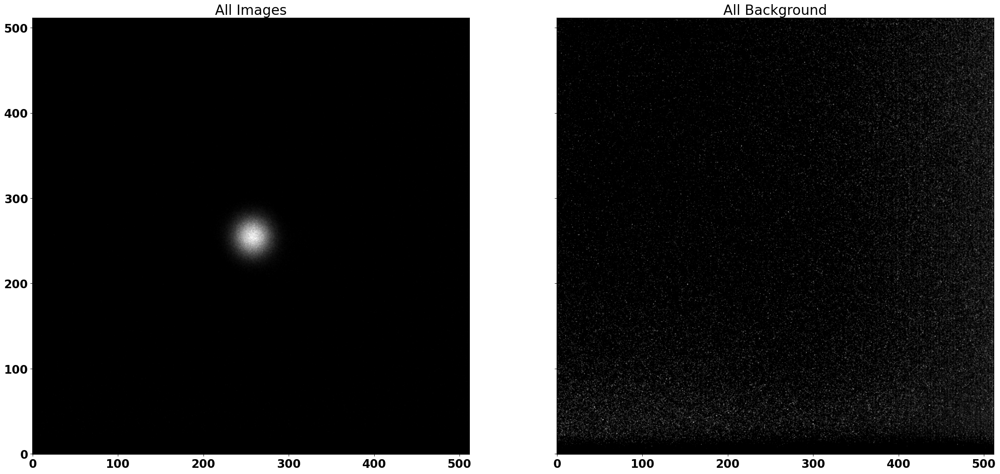

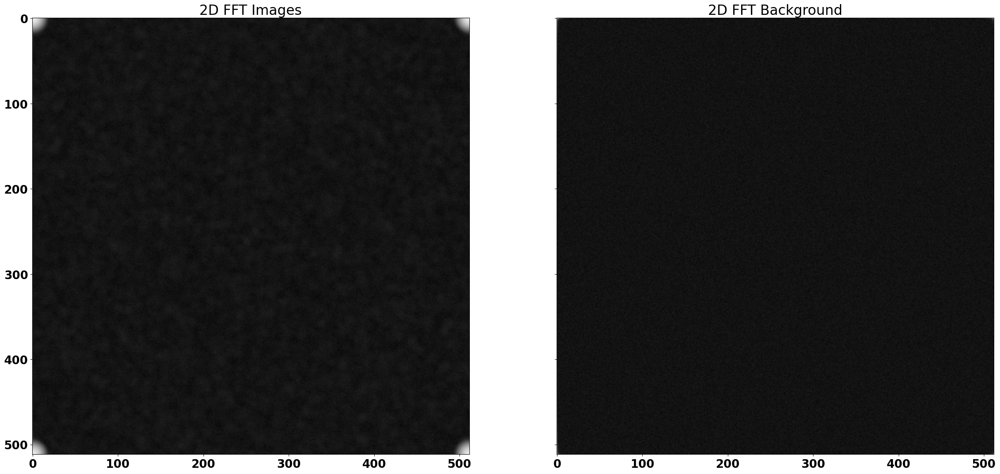

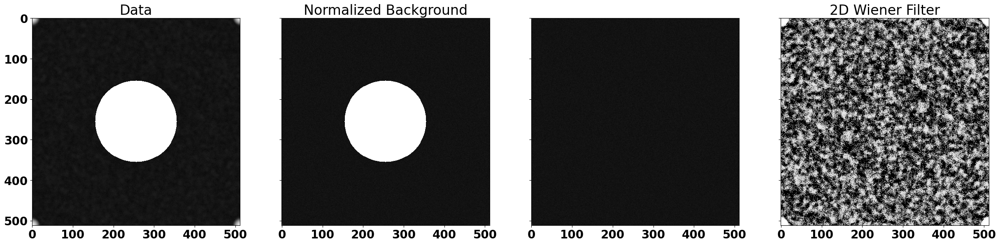

In [6]:
##### Day 1 For All the Images ####
pws=getPowerSpectrum(NoisyTracks,SimBg,"SimWiener",xlow=1,xhigh=100)

In [7]:
print (np.max(pws[0]))

0.9998471536514298


In [8]:
#Wiener2x=Wiener2x1DNormed(pws[2],pws[1],"WienerX",xlow=25,xhigh=40,ylow=25,yhigh=40,ZeroOut=False,ReadFile=False)
#xx,yy=np.meshgrid(Wiener2x[0],Wiener2x[1])



findfont: Font family ['arial'] not found. Falling back to DejaVu Sans.


Minimum kval = 0 and Maximum kval= 254


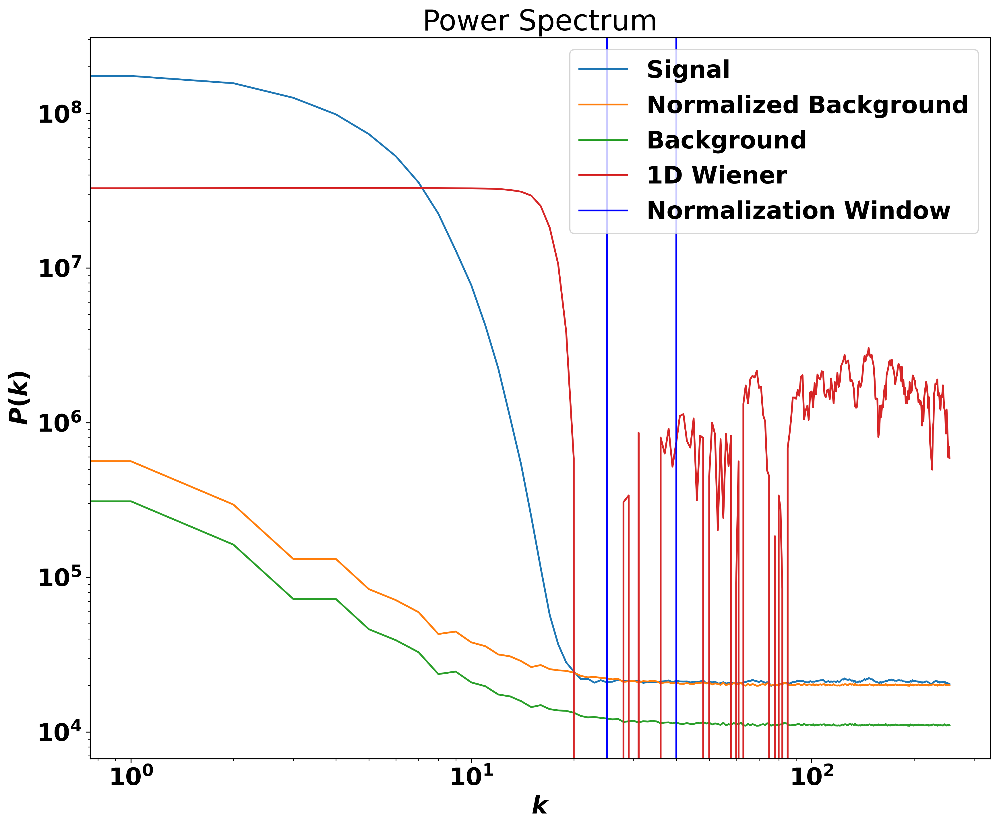

XXX

[[  0.           1.00195695   2.00391389 ... 509.99608611 510.99804305
  512.        ]
 [  0.           1.00195695   2.00391389 ... 509.99608611 510.99804305
  512.        ]
 [  0.           1.00195695   2.00391389 ... 509.99608611 510.99804305
  512.        ]
 ...
 [  0.           1.00195695   2.00391389 ... 509.99608611 510.99804305
  512.        ]
 [  0.           1.00195695   2.00391389 ... 509.99608611 510.99804305
  512.        ]
 [  0.           1.00195695   2.00391389 ... 509.99608611 510.99804305
  512.        ]]
YYY

[[  0.           0.           0.         ...   0.           0.
    0.        ]
 [  1.00195695   1.00195695   1.00195695 ...   1.00195695   1.00195695
    1.00195695]
 [  2.00391389   2.00391389   2.00391389 ...   2.00391389   2.00391389
    2.00391389]
 ...
 [509.99608611 509.99608611 509.99608611 ... 509.99608611 509.99608611
  509.99608611]
 [510.99804305 510.99804305 510.99804305 ... 510.99804305 510.99804305
  510.99804305]
 [512.         512.         51

In [9]:
### Increase array size to 512 

Wiener1d=PpectrumRadial(pws[2],pws[1],"Power Spectrum","",xlow=25,xhigh=40,ZeroOut=False)
WienerR=RadialFilter(Wiener1d,512,255,255,255)
print(f"Length of Wiener Filter {len(Wiener1d)}")


In [10]:
H = gkern(l=11, sig=2.1863625528548574, eta=0.823191927553376)
FT_H = np.fft.fft2(H, (512,512))

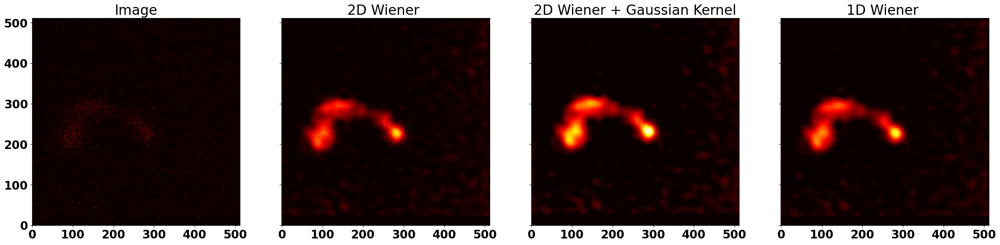

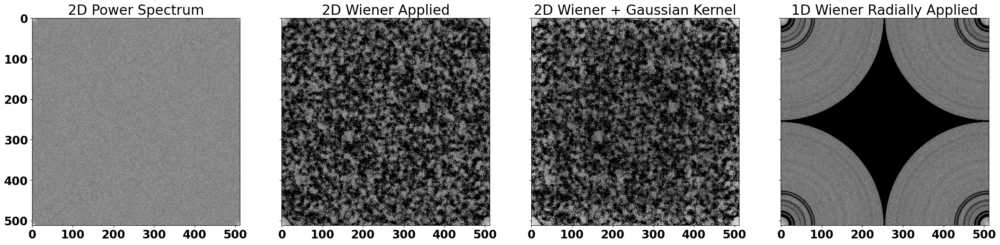

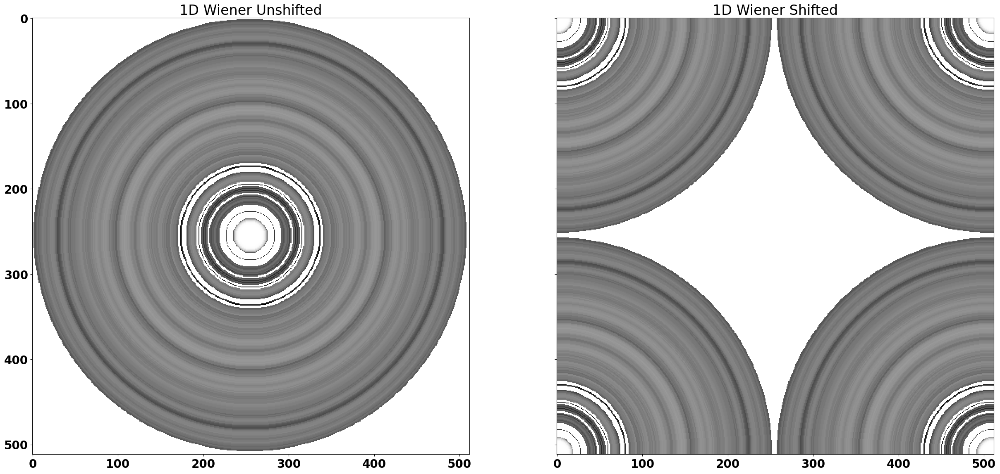

In [11]:
# ones=np.ones((25,25))/25
#ones=np.pad(ones,[(0, pws[2].shape[0]-ones.shape[0]), (0, pws[2].shape[1]-ones.shape[1])], mode='constant', constant_values=0)
#test=np.flip(test)
#### Single Image Recovery

SingleImg=NoisyTracks[19]
#SingleImg=NoisyTracks[40]
fft_SingleImg=np.fft.fft2(SingleImg)

#print(fft_SingleImg[0])

## 2D wiener
restored2DWiener = (fft_SingleImg*pws[0])
restored2DWiener = np.fft.ifft2(restored2DWiener)
restored2DWiener = np.real(restored2DWiener)


## 1D Wiener Radially Applied
restored1DWienerR=np.fft.fftshift(fft_SingleImg)*WienerR
restored1DWienerR=np.fft.ifftshift(restored1DWienerR)
restored1DWienerR = np.fft.ifft2(restored1DWienerR)
restored1DWienerR = np.real(restored1DWienerR)


##### Gaussian Filter Applied

GaussianF=(fft_SingleImg*pws[0]*FT_H)
GaussianF=np.fft.ifft2(GaussianF)
GaussianF=np.real(GaussianF)


## 1D Wiener X,Y Applied
'''restored1DWienerXY=fft_SingleImg*xx*yy
restored1DWienerXY = np.fft.ifft2(restored1DWienerXY)
restored1DWienerXY = np.real(restored1DWienerXY)'''
fig, ax = plt.subplots(nrows=1, ncols=4, figsize=(30, 20), sharex=True, sharey=True)
ax[0].set_title('Image')
ax[0].imshow(SingleImg,cmap=plt.get_cmap('hot'),origin="lower", interpolation='nearest',vmin=(np.mean(SingleImg)), vmax=np.max(SingleImg))
ax[1].set_title('2D Wiener ')
ax[1].imshow(restored2DWiener,cmap=plt.get_cmap('hot'),origin="lower",vmin=(np.mean(restored2DWiener)), vmax=np.max(restored2DWiener))
ax[3].set_title('1D Wiener ')
ax[3].imshow(restored1DWienerR,cmap=plt.get_cmap('hot'),origin="lower",vmin=(np.mean(restored1DWienerR)), vmax=np.max(restored1DWienerR))
ax[2].set_title('2D Wiener + Gaussian Kernel')
ax[2].imshow(GaussianF,cmap=plt.get_cmap('hot'),origin="lower",vmin=(np.mean(GaussianF)), vmax=np.max(GaussianF))
#ax[3].set_title('1D wiener XY applied')
#ax[3].imshow(restored1DWienerXY,cmap=plt.get_cmap('hot'),origin="lower",norm=LogNorm(vmin=np.mean(restored1DWienerXY), vmax=np.max(restored1DWienerXY)))
#ax[3].set_title('Median')
#ax[3].imshow(test,cmap=plt.get_cmap('hot'),origin="lower", interpolation='nearest',vmin=(np.mean(test)), vmax=np.max(test))

#restore5 = restore5.clip(0,255).astype(np.uint8)

#ax[1].imshow(20*np.log10(abs(fft_SingleImg)*),cmap='gray')
plt.show()

fft2dSpectrum=10*np.log10(np.abs(fft_SingleImg)**2*np.fft.fftshift(WienerR))
#fft2dWienerSpectrum=10*np.log10(np.abs(fft_SingleImg)**2*pws[0])
fft2dWienerSpectrum=10*np.log10(np.abs(fft_SingleImg)**2*pws[0])
GaussianFilter=10*np.log10(np.abs(fft_SingleImg)**2*pws[0]*np.abs(FT_H)**2)
fig, ax = plt.subplots(nrows=1, ncols=4, figsize=(30, 20), sharex=False, sharey=True)
#ax[0].set_title('2D FFT')
#ax[0].imshow(10*np.log10(np.abs(fft_SingleImg)**2),cmap='gray')
ax[0].set_title('2D Power Spectrum')
ax[0].imshow(10*np.log10(np.abs(fft_SingleImg)**2),cmap='gray')
ax[1].set_title('2D Wiener Applied')
ax[1].imshow(RemoveInf(fft2dWienerSpectrum),cmap='gray')
ax[3].set_title('1D Wiener Radially Applied')
ax[3].imshow(RemoveInf(fft2dSpectrum),cmap='gray')
ax[2].set_title('2D Wiener + Gaussian Kernel')
ax[2].imshow(RemoveInf(GaussianFilter),cmap='gray')
#ax[3].set_title('2x1D_wiener XY Applied')
#ax[3].imshow(10*np.log10(np.abs(fft_SingleImg)**2*xx*yy),cmap='gray')

#ax[1].set_title('2D Weiner applied')
#ax[1].imshow(10*np.log10(np.abs(np.fft.fft(restored))),cmap='gray')
#ax[2].set_title('1D Weiner applied')
#ax[2].imshow(10*np.log10(np.abs(np.fft.fft(restored2))),cmap='gray')
plt.show()


fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(30, 20), sharex=False, sharey=True)
ax[0].set_title('1D Wiener Unshifted')
ax[0].imshow(10*np.log10(WienerR),cmap='gray')
ax[1].set_title('1D Wiener Shifted')
ax[1].imshow(10*np.log10(np.fft.fftshift(WienerR)),cmap='gray')
#ax[3].set_title('2x1D_wiener XY Applied')
#ax[3].imshow(10*np.log10(np.abs(fft_SingleImg)**2*xx*yy),cmap='gray')

#ax[1].set_title('2D Weiner applied')
#ax[1].imshow(10*np.log10(np.abs(np.fft.fft(restored))),cmap='gray')
#ax[2].set_title('1D Weiner applied')
#ax[2].imshow(10*np.log10(np.abs(np.fft.fft(restored2))),cmap='gray')
plt.show()




Img Dimension --> 512x512
[[0.         0.94275027 0.98822    ... 0.98817482 0.98822    0.94275027]
 [0.95210622 0.99904043 0.99963471 ... 0.99960383 0.99963018 0.99926793]
 [0.87695374 0.99935495 0.99956297 ... 0.99956498 0.9995847  0.99917249]
 ...
 [0.78623001 0.9992642  0.99952406 ... 0.99948906 0.99949489 0.99915733]
 [0.87695374 0.99917249 0.9995847  ... 0.99957999 0.99956297 0.99935495]
 [0.95210622 0.99926793 0.99963018 ... 0.99960619 0.99963471 0.99904043]]


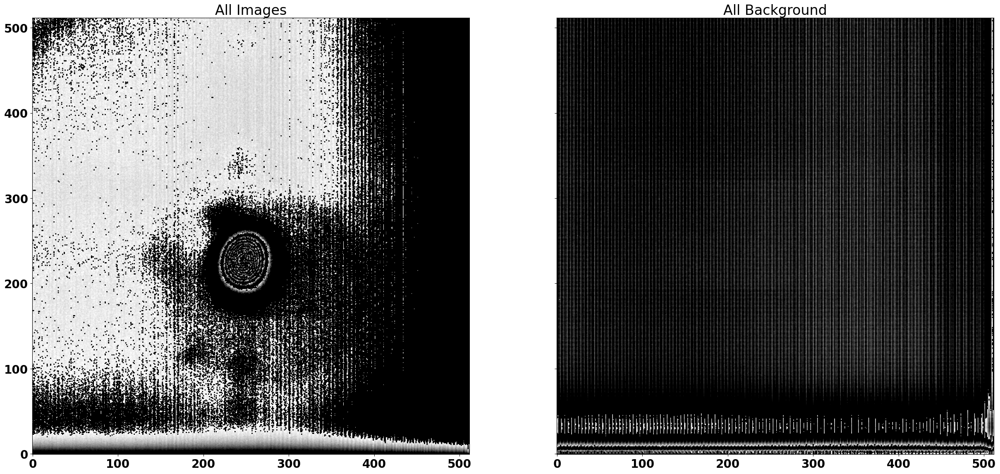

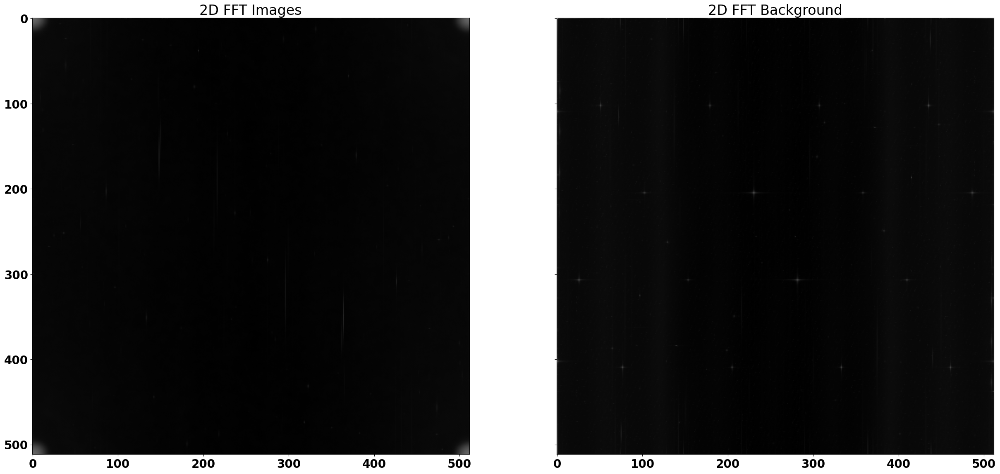

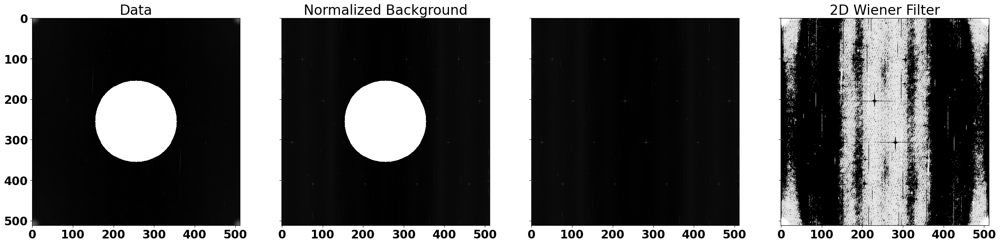

In [12]:
##### Day2
pwsday2=getPowerSpectrum(ELDay2Images,BackGroundDay2,"WienerDay2",xlow=1,xhigh=100)

Minimum kval = 1.0 and Maximum kval= 256.0


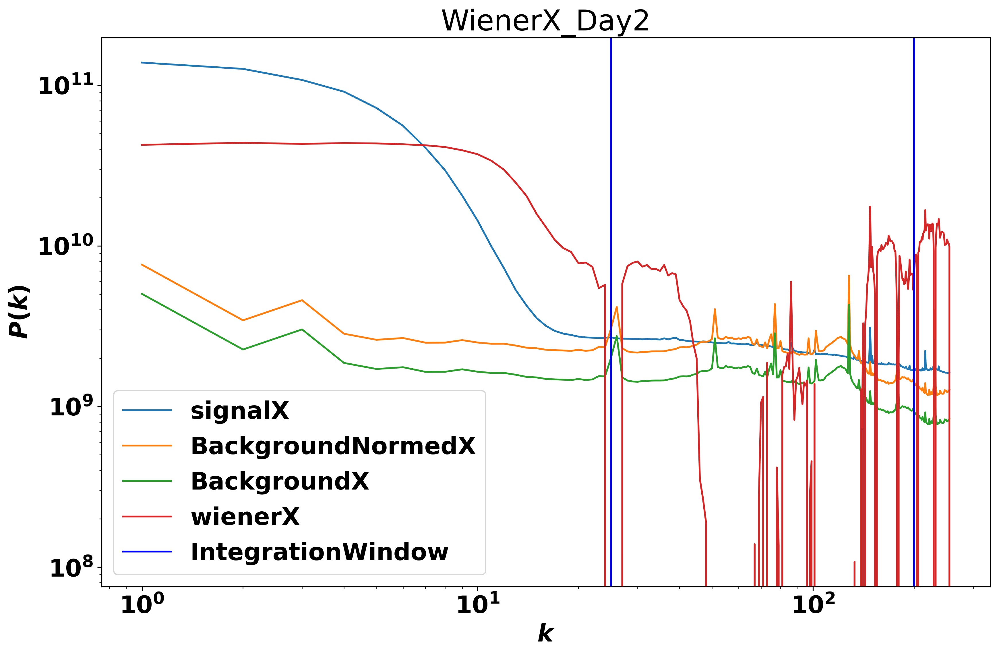

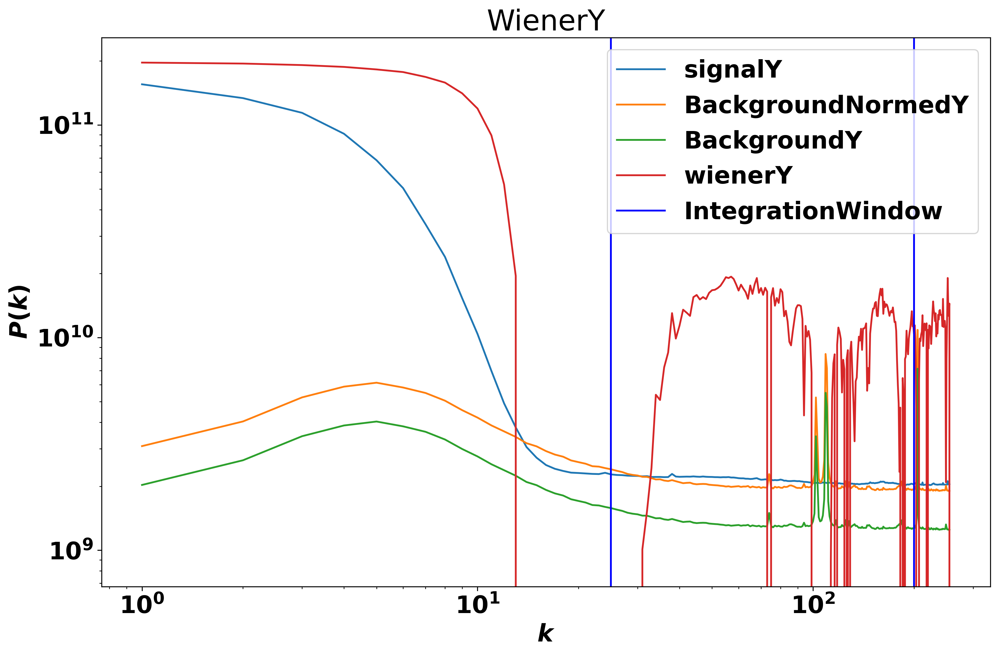

In [13]:
Wiener2xDay2=Wiener2x1DNormed(pwsday2[2],pwsday2[1],"WienerX_Day2",xlow=25,xhigh=200,ZeroOut=False,ReadFile=False)
xx2,yy2=np.meshgrid(Wiener2xDay2[0],Wiener2xDay2[1])

npix
512
kfreq
[   0.    1.    2.    3.    4.    5.    6.    7.    8.    9.   10.   11.
   12.   13.   14.   15.   16.   17.   18.   19.   20.   21.   22.   23.
   24.   25.   26.   27.   28.   29.   30.   31.   32.   33.   34.   35.
   36.   37.   38.   39.   40.   41.   42.   43.   44.   45.   46.   47.
   48.   49.   50.   51.   52.   53.   54.   55.   56.   57.   58.   59.
   60.   61.   62.   63.   64.   65.   66.   67.   68.   69.   70.   71.
   72.   73.   74.   75.   76.   77.   78.   79.   80.   81.   82.   83.
   84.   85.   86.   87.   88.   89.   90.   91.   92.   93.   94.   95.
   96.   97.   98.   99.  100.  101.  102.  103.  104.  105.  106.  107.
  108.  109.  110.  111.  112.  113.  114.  115.  116.  117.  118.  119.
  120.  121.  122.  123.  124.  125.  126.  127.  128.  129.  130.  131.
  132.  133.  134.  135.  136.  137.  138.  139.  140.  141.  142.  143.
  144.  145.  146.  147.  148.  149.  150.  151.  152.  153.  154.  155.
  156.  157.  158.  159.  160.  161.

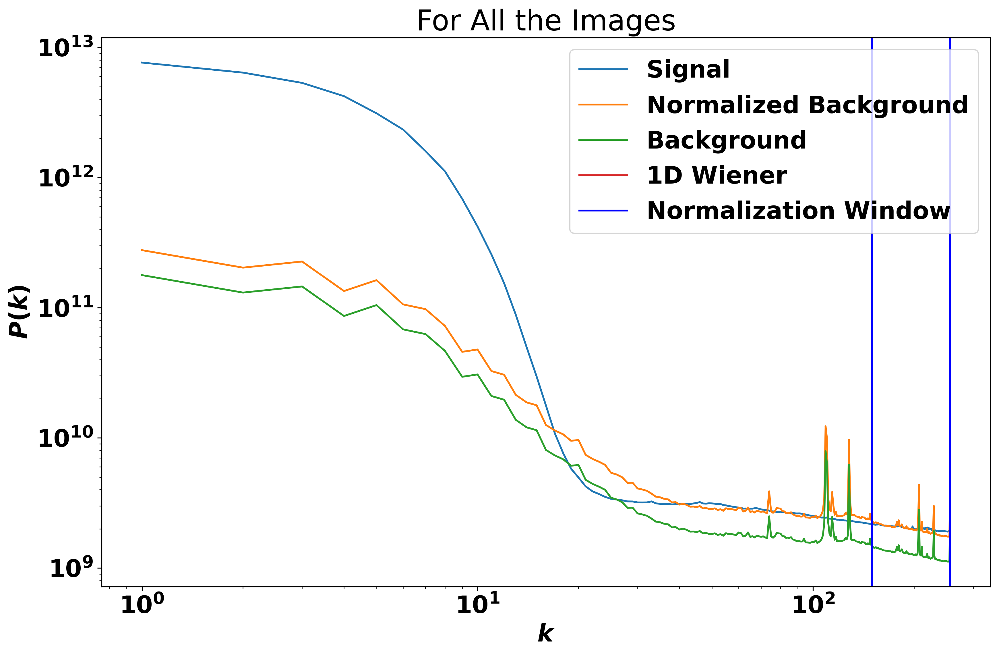

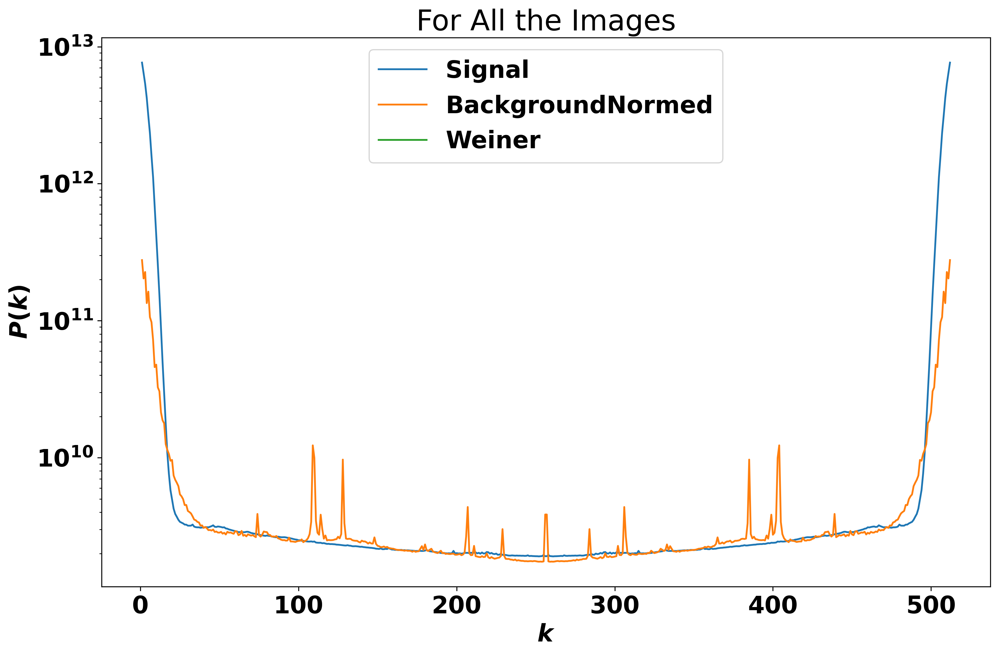

XXX

[[  0.           1.00195695   2.00391389 ... 509.99608611 510.99804305
  512.        ]
 [  0.           1.00195695   2.00391389 ... 509.99608611 510.99804305
  512.        ]
 [  0.           1.00195695   2.00391389 ... 509.99608611 510.99804305
  512.        ]
 ...
 [  0.           1.00195695   2.00391389 ... 509.99608611 510.99804305
  512.        ]
 [  0.           1.00195695   2.00391389 ... 509.99608611 510.99804305
  512.        ]
 [  0.           1.00195695   2.00391389 ... 509.99608611 510.99804305
  512.        ]]
YYY

[[  0.           0.           0.         ...   0.           0.
    0.        ]
 [  1.00195695   1.00195695   1.00195695 ...   1.00195695   1.00195695
    1.00195695]
 [  2.00391389   2.00391389   2.00391389 ...   2.00391389   2.00391389
    2.00391389]
 ...
 [509.99608611 509.99608611 509.99608611 ... 509.99608611 509.99608611
  509.99608611]
 [510.99804305 510.99804305 510.99804305 ... 510.99804305 510.99804305
  510.99804305]
 [512.         512.         51

In [14]:
#### Day 1 ####
#PlotPowerSpect(pws[2],pws[1],"Day_1_All_Images")
Wiener1d_Day2=PpectrumNormed(pwsday2[2],pwsday2[1],"For All the Images","WienerDay2.p",xlow=150,xhigh=256,ZeroOut=False)
WienerRDay2=RadialFilter(Wiener1d_Day2[1],512,255,255,255)


In [15]:
### Day2
#PlotPowerSpect(pwsday2[2],pwsday2[1],"Day_2")
pwsday2[2]

array([[2.90319599e+17, 1.03421746e+12, 1.17394639e+12, ...,
        8.34301668e+11, 1.17394639e+12, 1.03421746e+12],
       [1.36552960e+12, 1.25162153e+12, 1.00684574e+12, ...,
        8.45511505e+11, 9.97597611e+11, 1.22308020e+12],
       [1.00421813e+12, 9.77735943e+11, 8.81969467e+11, ...,
        7.61037060e+11, 8.84124485e+11, 9.63726008e+11],
       ...,
       [9.11275165e+11, 8.06533362e+11, 7.39803592e+11, ...,
        6.32858990e+11, 7.16834496e+11, 7.97253780e+11],
       [1.00421813e+12, 9.63726008e+11, 8.84124485e+11, ...,
        7.52171148e+11, 8.81969467e+11, 9.77735943e+11],
       [1.36552960e+12, 1.22308020e+12, 9.97597611e+11, ...,
        8.46373681e+11, 1.00684574e+12, 1.25162153e+12]])

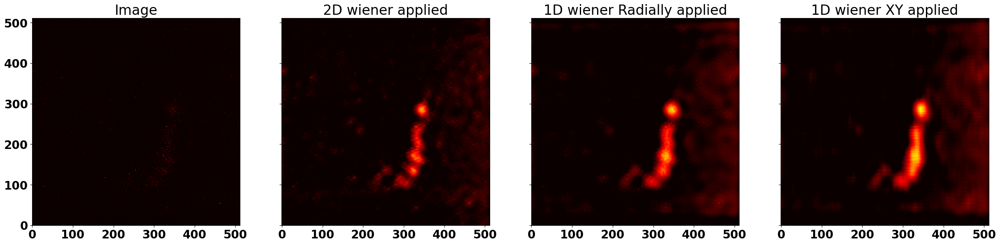

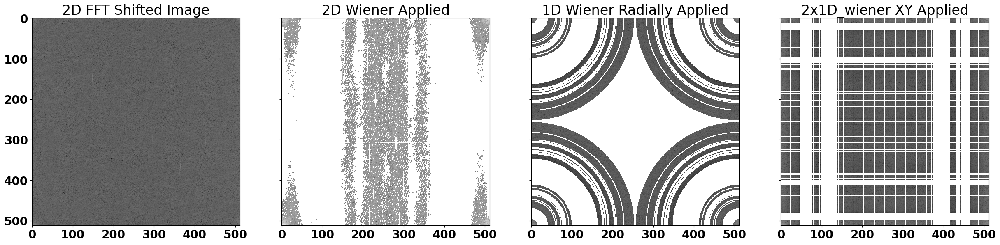

In [16]:
# ones=np.ones((15,15))/100
#ones=np.pad(ones,[(0, pws[2].shape[0]-ones.shape[0]), (0, pws[2].shape[1]-ones.shape[1])], mode='constant', constant_values=0)

#### Single Image Recovery
#SingleImg=ELDay2Images[935]
#print(increment)

#print(PS_SingleImg)
#for i in increment:
SingleImg=ELDay2Images[935]

fft_SingleImg=np.fft.fft2(SingleImg)


## 2D wiener
restored2DWiener = fft_SingleImg*pwsday2[0]
restored2DWiener = np.fft.ifft2(restored2DWiener)
restored2DWiener = np.real(restored2DWiener)


## 1D Wiener Radially Applied
restored1DWienerR=np.fft.fftshift(fft_SingleImg)*WienerRDay2
restored1DWienerR=np.fft.ifftshift(restored1DWienerR)
restored1DWienerR = np.fft.ifft2(restored1DWienerR)
restored1DWienerR = np.real(restored1DWienerR)


## 1D Wiener X,Y Applied
restored1DWienerXY=fft_SingleImg*xx2*yy2
restored1DWienerXY = np.fft.ifft2(restored1DWienerXY)
restored1DWienerXY = np.real(restored1DWienerXY)

fig, ax = plt.subplots(nrows=1, ncols=4, figsize=(30, 20), sharex=True, sharey=True)
ax[0].set_title('Image')
ax[0].imshow(SingleImg,cmap=plt.get_cmap('hot'),origin="lower", interpolation='nearest',vmin=(np.mean(SingleImg)), vmax=np.max(SingleImg))
ax[1].set_title('2D wiener applied')
ax[1].imshow(restored2DWiener,cmap=plt.get_cmap('hot'),origin="lower",vmin=(np.mean(restored2DWiener)), vmax=np.max(restored2DWiener))
ax[2].set_title('1D wiener Radially applied')
ax[2].imshow(restored1DWienerR,cmap=plt.get_cmap('hot'),origin="lower",vmin=(np.mean(restored1DWienerR)), vmax=np.max(restored1DWienerR))
ax[3].set_title('1D wiener XY applied')
ax[3].imshow(restored1DWienerXY,cmap=plt.get_cmap('hot'),origin="lower",vmin=(np.mean(restored1DWienerXY)), vmax=np.max(restored1DWienerXY))


plt.show()

fft2dSpectrum=10*np.log10(np.abs(fft_SingleImg)**2*np.fft.fftshift(WienerRDay2))
fft2dWienerSpectrum=10*np.log10(np.abs(fft_SingleImg)**2*pwsday2[0])
fig, ax = plt.subplots(nrows=1, ncols=4, figsize=(30, 20), sharex=True, sharey=True)
ax[0].set_title('2D FFT Shifted Image')
ax[0].imshow(10*np.log10(np.abs(fft_SingleImg)**2),cmap='gray')
ax[1].set_title('2D Wiener Applied')
ax[1].imshow(fft2dWienerSpectrum,cmap='gray')
ax[2].set_title('1D Wiener Radially Applied')
ax[2].imshow(fft2dSpectrum,cmap='gray')
ax[3].set_title('2x1D_wiener XY Applied')

ax[3].imshow(10*np.log10(np.abs(fft_SingleImg)**2*xx2*yy2),cmap='gray')

#ax[1].set_title('2D Weiner applied')
plt.show()

Img Dimension --> 512x512
[[ 0.00000000e+00  2.03101698e-01 -8.04403020e-03 ... -6.66127568e-01
  -8.04403020e-03  2.03101698e-01]
 [-7.83489393e-01  8.94294460e-01  9.63356764e-01 ...  9.34734306e-01
   9.37891205e-01  9.46485342e-01]
 [-1.63732880e+01  8.89569566e-01  9.66793767e-01 ...  8.12437124e-01
   9.31402808e-01  9.27472279e-01]
 ...
 [ 3.82570580e-01  8.73062493e-01  9.08788524e-01 ...  8.21485759e-01
   8.48042928e-01  8.42415403e-01]
 [-1.63732880e+01  9.27472279e-01  9.31402808e-01 ...  9.01051563e-01
   9.66793767e-01  8.89569566e-01]
 [-7.83489393e-01  9.46485342e-01  9.37891205e-01 ...  9.28451661e-01
   9.63356764e-01  8.94294460e-01]]


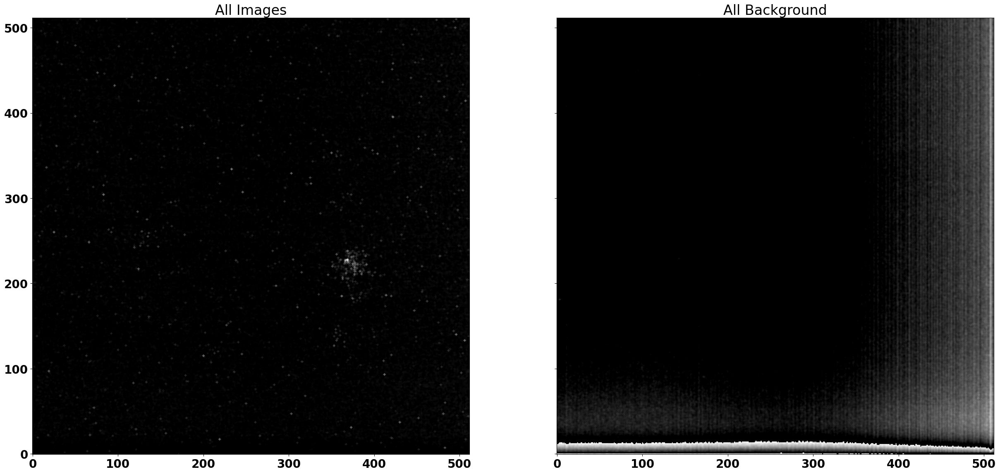

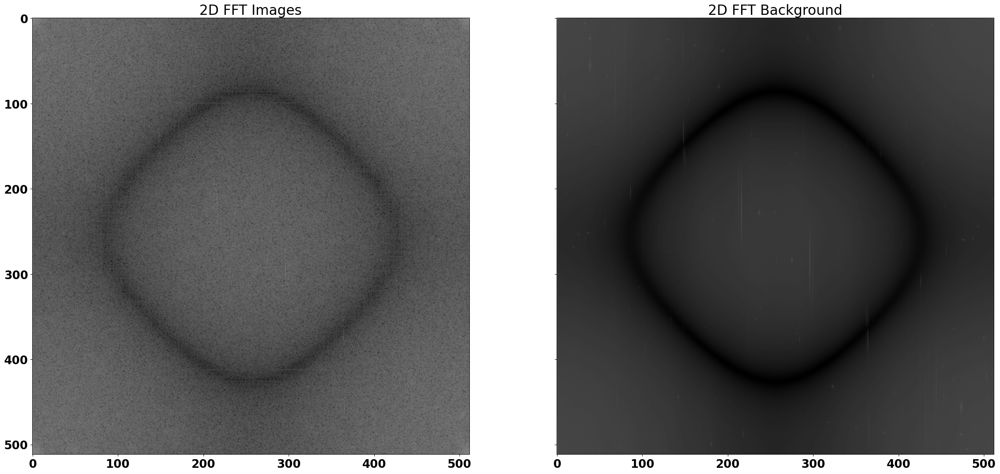

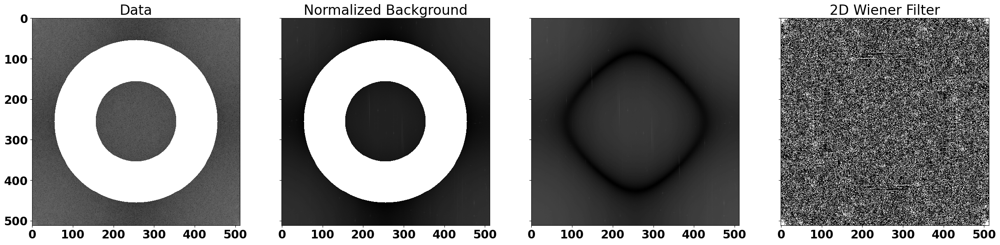

npix
512
kfreq
[   0.    1.    2.    3.    4.    5.    6.    7.    8.    9.   10.   11.
   12.   13.   14.   15.   16.   17.   18.   19.   20.   21.   22.   23.
   24.   25.   26.   27.   28.   29.   30.   31.   32.   33.   34.   35.
   36.   37.   38.   39.   40.   41.   42.   43.   44.   45.   46.   47.
   48.   49.   50.   51.   52.   53.   54.   55.   56.   57.   58.   59.
   60.   61.   62.   63.   64.   65.   66.   67.   68.   69.   70.   71.
   72.   73.   74.   75.   76.   77.   78.   79.   80.   81.   82.   83.
   84.   85.   86.   87.   88.   89.   90.   91.   92.   93.   94.   95.
   96.   97.   98.   99.  100.  101.  102.  103.  104.  105.  106.  107.
  108.  109.  110.  111.  112.  113.  114.  115.  116.  117.  118.  119.
  120.  121.  122.  123.  124.  125.  126.  127.  128.  129.  130.  131.
  132.  133.  134.  135.  136.  137.  138.  139.  140.  141.  142.  143.
  144.  145.  146.  147.  148.  149.  150.  151.  152.  153.  154.  155.
  156.  157.  158.  159.  160.  161.

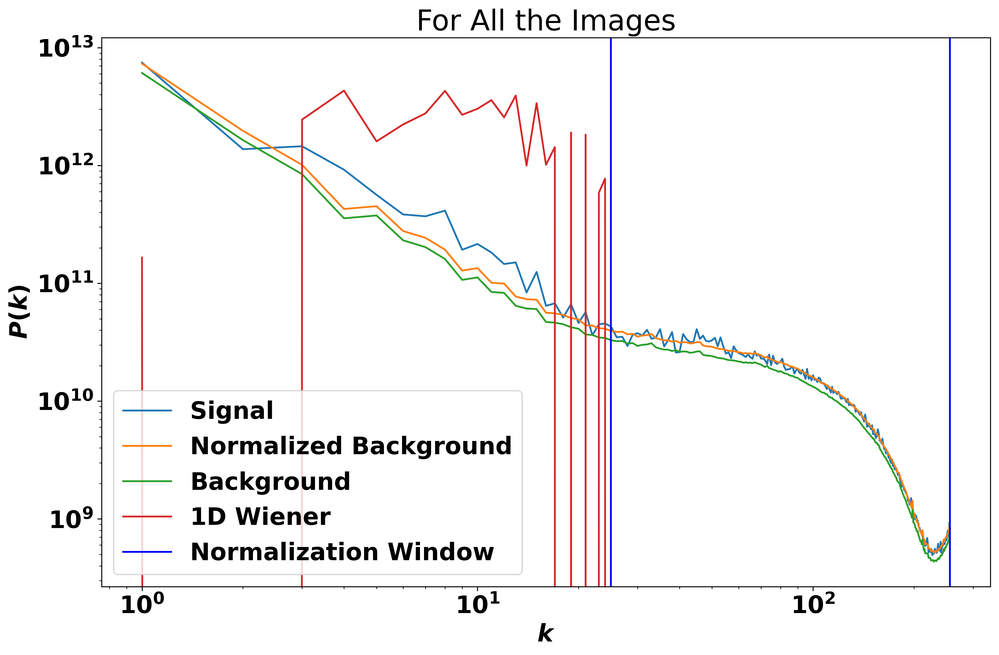

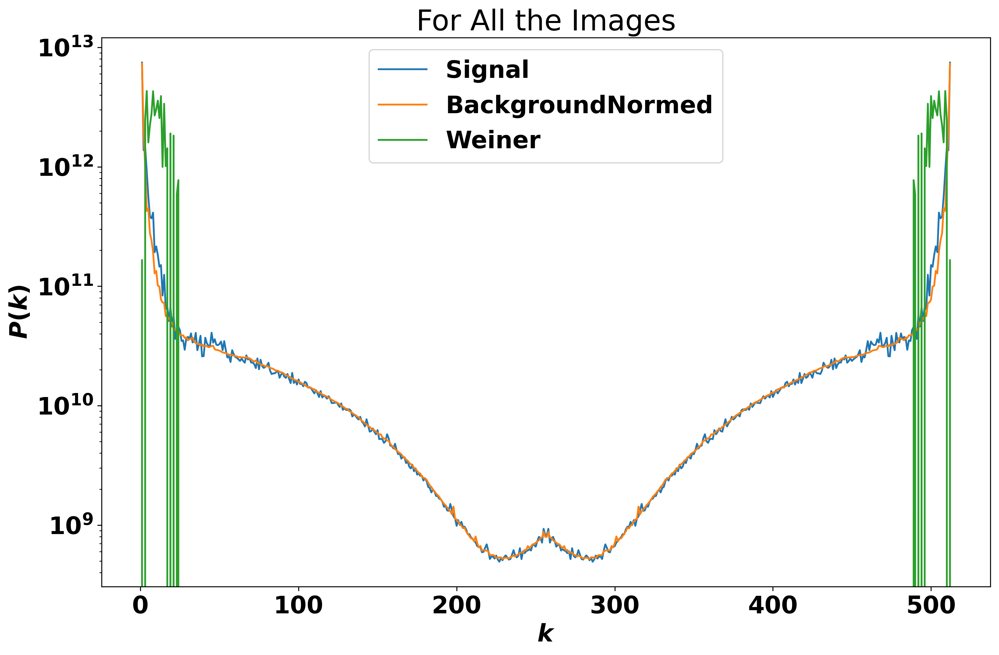

In [17]:
test={}
test[0]=ELDay1Images[150]
bgn={}
count=0
for i in range(500,1000):
    
    bgn[count]=BackGround[i]
    count+=1

testpws=getPowerSpectrum(test,bgn,"wiener_test")
plt.show()
testWiener1d=PpectrumNormed(testpws[2],testpws[1],"For All the Images","wiener_test.p",ZeroOut=True)


In [18]:
from scipy.ndimage import rotate

restored=np.fft.ifft2(np.fft.fft2(test[0])*(testWiener1d))
Angle=90
Times=int(360/Angle)
for i in range (0,Times):
    print(Angle)
    restored=rotate(np.real(restored), Angle,reshape=False)
    restored=np.fft.fft2(restored)*testWiener1d
    restored=np.real(np.fft.ifft2(restored))
    
    
restored2=np.fft.ifft2(np.fft.fft2(test[0])*(yy.T*yy*xx.T*yy.T))
restored2=np.real(restored2)



fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(50, 50))
ax[0].set_title('Image')
ax[0].imshow(test[0],cmap=plt.get_cmap('hot'),origin="lower",vmin=np.mean(test[0]), vmax=np.max(test[0]))
ax[1].set_title('2D Wiener')
ax[1].imshow(restored2,cmap=plt.get_cmap('hot'),origin="lower",vmin=np.mean(restored2), vmax=np.max(restored2))
ax[2].set_title('1D Wiener')
ax[2].imshow(restored,cmap=plt.get_cmap('hot'),origin="lower",vmin=np.mean(restored), vmax=np.max(restored))


plt.show()

ValueError: operands could not be broadcast together with shapes (512,512) (2,) 

In [ ]:
img=Image.open("/home/ilker/img.jpg")
img=img.convert("1")
img=np.array(img)

In [ ]:
testfilter=np.ones(256)

test=RadialFilter(testfilter,img.shape[0],256,255,255)

In [ ]:

def azimuthalAverage(image, center=None):
    """
    Calculate the azimuthally averaged radial profile.

    image - The 2D image
    center - The [x,y] pixel coordinates used as the center. The default is 
             None, which then uses the center of the image (including 
             fracitonal pixels).
    
    """
    # Calculate the indices from the image
    y, x = np.indices(image.shape)

    if not center:
        center = np.array([(x.max()-x.min())/2.0, (x.max()-x.min())/2.0])

    r = np.hypot(x - center[0], y - center[1])

    # Get sorted radii
    ind = np.argsort(r.flat)
    r_sorted = r.flat[ind]
    i_sorted = image.flat[ind]

    # Get the integer part of the radii (bin size = 1)
    r_int = r_sorted.astype(int)

    # Find all pixels that fall within each radial bin.
    deltar = r_int[1:] - r_int[:-1]  # Assumes all radii represented
    rind = np.where(deltar)[0]       # location of changed radius
    nr = rind[1:] - rind[:-1]        # number of radius bin
    
    # Cumulative sum to figure out sums for each radius bin
    csim = np.cumsum(i_sorted, dtype=float)
    tbin = csim[rind[1:]] - csim[rind[:-1]]

    radial_prof = tbin / nr

    return radial_prof



    


In [ ]:

BG=RadialAverage(pws[1],255)
Signal=RadialAverage(pws[2],255)

print(BG)
plt.loglog(BG)
plt.loglog(Signal)
plt.show()

In [ ]:
print(goodBeta[3])

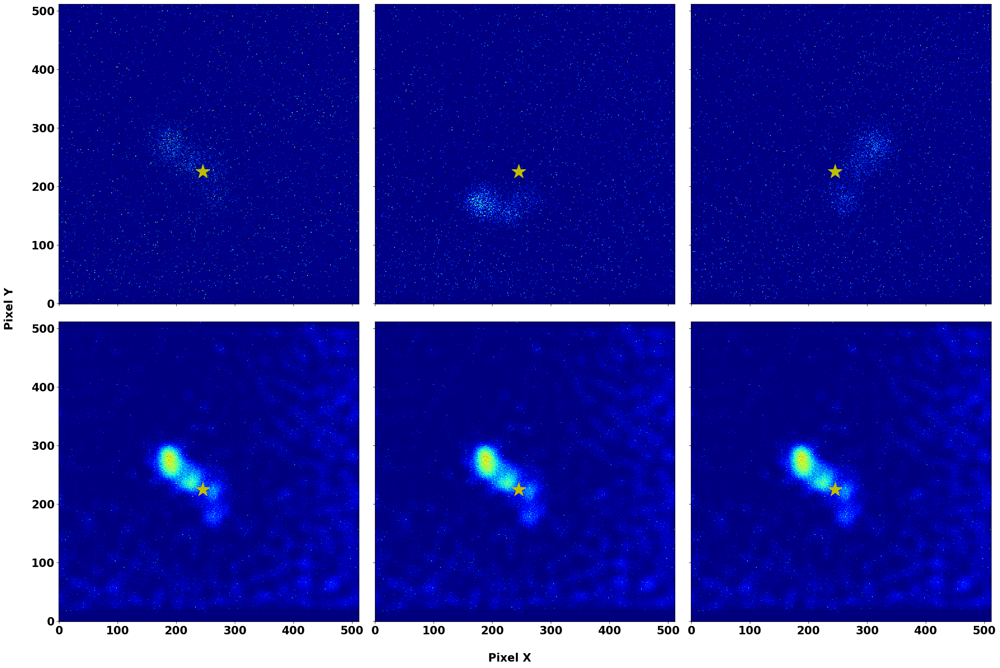

In [19]:
###### good beta events

fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(30, 20), sharex=True, sharey=True)

fig.text(0.5, 0.06, 'Pixel X', ha='center')
fig.text(0.08, 0.5, 'Pixel Y', va='center', rotation='vertical')


#### alphas
ax[0][0].imshow(goodBeta[1],cmap=plt.get_cmap('jet'),origin="lower", interpolation='nearest',vmin=(np.mean(goodBeta[1])), vmax=np.max(goodBeta[1])*0.7)
ax[0][1].imshow(goodBeta[2],cmap=plt.get_cmap('jet'),origin="lower",vmin=(np.mean(goodBeta[2])), vmax=np.max(goodBeta[2])*0.55)
ax[0][2].imshow(goodBeta[3],cmap=plt.get_cmap('jet'),origin="lower",vmin=(np.mean(goodBeta[3])), vmax=np.max(goodBeta[3])*0.5)
for i in range(0,3):
    ax[0][i].scatter([245],[225],s=700,color="y",marker="*")
fftimg=np.fft.fft2(goodBeta[1])
restored2DWiener = (fftimg*pws[0])
restored2DWiener = np.fft.ifft2(restored2DWiener)
restored2DWiener = np.real(restored2DWiener)
ax[1][0].imshow(restored2DWiener,cmap=plt.get_cmap('jet'),origin="lower", interpolation='nearest',vmin=(np.mean(restored2DWiener)), vmax=np.max(restored2DWiener))
fftimg=np.fft.fft2(goodBeta[1])
restored2DWiener = (fftimg*pws[0])
restored2DWiener = np.fft.ifft2(restored2DWiener)
restored2DWiener = np.real(restored2DWiener)
ax[1][1].imshow(restored2DWiener,cmap=plt.get_cmap('jet'),origin="lower", interpolation='nearest',vmin=(np.mean(restored2DWiener)), vmax=np.max(restored2DWiener))
fftimg=np.fft.fft2(goodBeta[1])
restored2DWiener = (fftimg*pws[0])
restored2DWiener = np.fft.ifft2(restored2DWiener)
restored2DWiener = np.real(restored2DWiener)
ax[1][2].imshow(restored2DWiener,cmap=plt.get_cmap('jet'),origin="lower", interpolation='nearest',vmin=(np.mean(restored2DWiener)), vmax=np.max(restored2DWiener))

for i in range(0,3):
    ax[1][i].scatter([245],[225],s=700,color="y",marker="*")

plt.subplots_adjust(wspace=0.05, hspace=0.06)
#fig.savefig("/home/ilker/Desktop/CRAB/SimBetas.png",bbox_inches='tight')

